# Визуализация данных с Matplotlib и Seaborn
#### Подключение библиотек и скриптов

In [36]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
# Считываем датасет
df = pd.read_csv('bank.csv', sep=",", quotechar='"')
df['month'] = pd.to_datetime(df['month'], format='%b')
# Вывод случайных 10 записей
df.sample(n=10)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
3363,33,blue-collar,married,secondary,no,467,yes,no,unknown,21,1900-05-01,494,2,-1,0,unknown,0
1985,29,student,single,unknown,no,145,no,no,cellular,14,1900-08-01,105,1,-1,0,unknown,0
1804,34,management,married,secondary,no,857,yes,no,cellular,22,1900-08-01,238,6,-1,0,unknown,0
1446,32,technician,single,tertiary,no,4665,yes,no,unknown,21,1900-05-01,860,2,-1,0,unknown,1
965,33,management,single,tertiary,no,3143,no,no,cellular,29,1900-06-01,421,2,-1,0,unknown,1
3905,24,blue-collar,married,secondary,no,0,no,no,unknown,28,1900-05-01,94,1,-1,0,unknown,0
2423,37,entrepreneur,single,secondary,no,654,no,no,unknown,19,1900-05-01,594,2,-1,0,unknown,0
1579,37,management,married,tertiary,no,539,no,no,cellular,18,1900-01-01,540,2,115,3,failure,0
61,63,retired,married,secondary,no,415,yes,no,cellular,7,1900-10-01,323,1,-1,0,unknown,0
2936,50,unemployed,divorced,secondary,no,717,yes,no,cellular,30,1900-01-01,113,1,-1,0,unknown,0


## Стандартный синтаксис создания графика

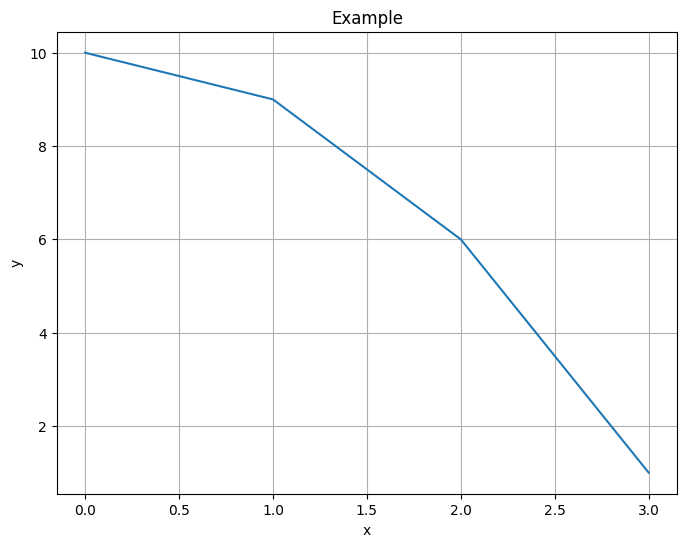

In [24]:
plt.figure(figsize=(8, 6))
plt.plot([0, 1, 2, 3], [10, 9, 6, 1])
plt.xlabel('x')
plt.ylabel('y')
plt.title('Example')
plt.grid()

## Виды графиков
### Линейный график

In [25]:
# Готовим данные для графика в виде сводной таблицы
data = df.groupby('month')['job'].agg(count='count').reset_index().sort_values(by='month')
data.head()

,month,count
0,1900-01-01,148
1,1900-02-01,222
2,1900-03-01,49
3,1900-04-01,293
4,1900-05-01,1398


#### Matplotlib

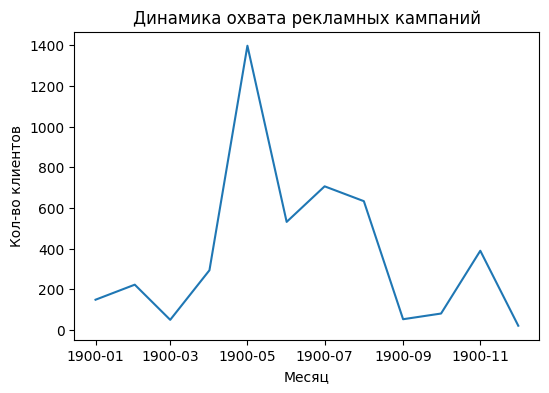

In [26]:
plt.figure(figsize=(6, 4))
plt.plot(data['month'], data['count'])
plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов');

#### Seaborn

In [46]:
plt.figure(figsize=(6, 4))
sns.lineplot(x=data['month'], y=data['count'])
plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов');

KeyError: 'month'

<Figure size 600x400 with 0 Axes>

### Гистограмма
#### Matplotlib

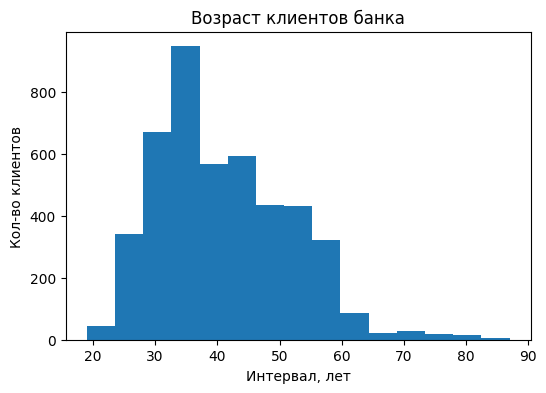

In [45]:
plt.figure(figsize=(6, 4))
plt.hist(df['age'], bins=15)
plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов');

#### Seaborn

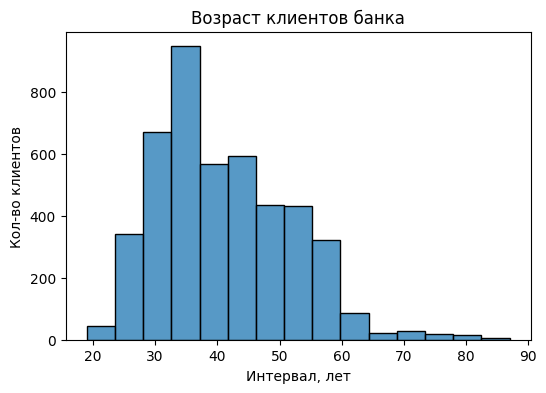

In [32]:
plt.figure(figsize=(6, 4))
sns.histplot(df['age'], bins=15)
plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов');

### Диаграмма рассеяния

In [37]:
# Готовим данные для графика в виде сводной таблицы
data = df.groupby('age')['y'].sum().reset_index()
data.head()

,age,y
0,19,2
1,20,1
2,21,1
3,22,3
4,23,2


#### Matplotlib

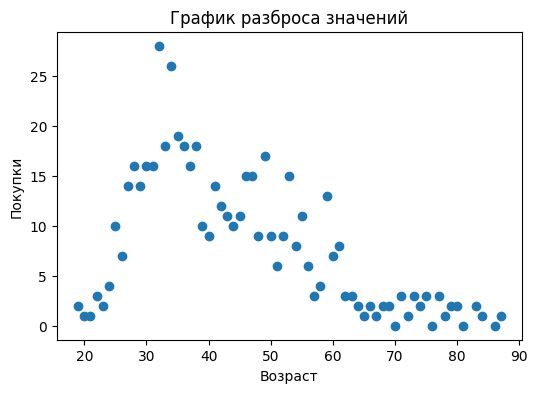

In [38]:
plt.figure(figsize=(6, 4))
plt.scatter(data['age'], data['y'])
plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Покупки');

#### Seaborn

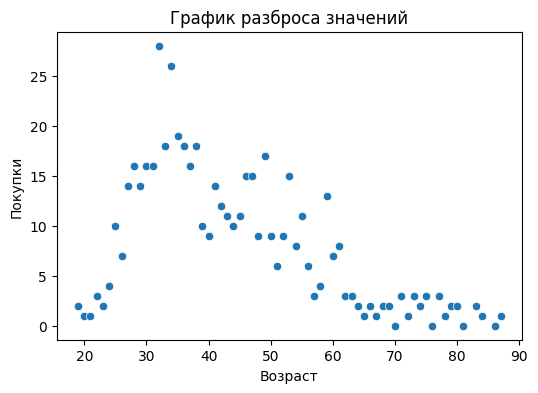

In [39]:
plt.figure(figsize=(6, 4))
sns.scatterplot(x=data['age'], y=data['y'])
plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Покупки');

### Столбчатые диаграммы

In [40]:
# Готовим данные для графика
data = df['job'].value_counts().reset_index()
data.head()

,index,job
0,management,969
1,blue-collar,946
2,technician,768
3,admin.,478
4,services,417


#### Matplotlib

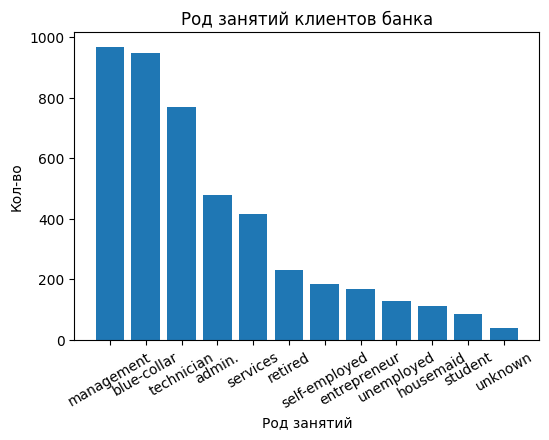

In [41]:
plt.figure(figsize=(6, 4))
plt.bar(data['index'], data['job'])
plt.title('Род занятий клиентов банка')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.xticks(rotation=30);

#### Seaborn

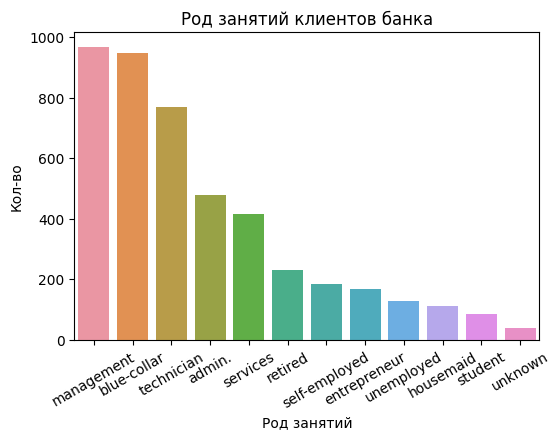

In [44]:
plt.figure(figsize=(6, 4))
sns.barplot(x=data['index'], y=data['job'])
plt.title('Род занятий клиентов банка')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.xticks(rotation=30);

### Многорядовые столбчатые диаграммы

In [47]:
# Готовим данные для графика
data = pd.crosstab(df['job'], df['y']).reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

y,job,no,yes
1,blue-collar,877,69
4,management,838,131
9,technician,685,83
0,admin.,420,58
7,services,379,38


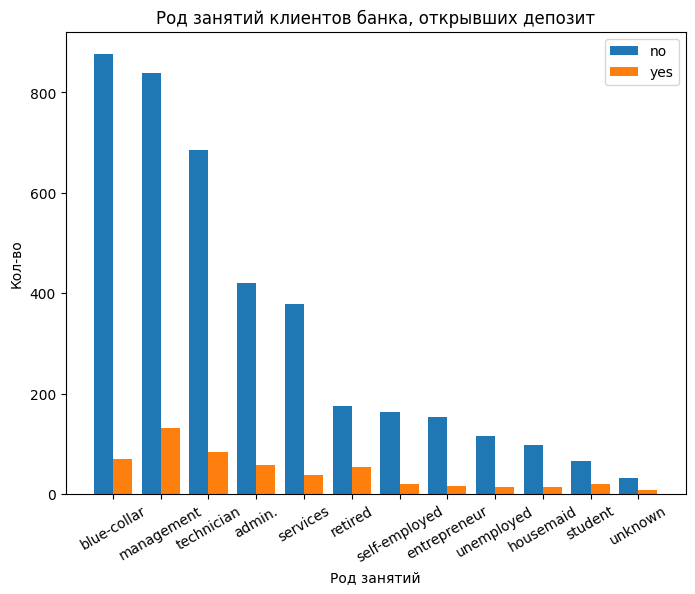

In [48]:
# Строим столбчатую многорядную диаграмму
plt.figure(figsize=(8, 6))
# определяем кол-во делений
n_ticks = np.arange(len(data['no']))
# определяем сдвиг
offset = 0.2
# определяем ширину столбцов
w = 0.4
# добавляем сдвиг к кол-ву делений
plt.bar(n_ticks - offset, data['no'], width=w)
plt.bar(n_ticks + offset, data['yes'], width=w)
plt.title('Род занятий клиентов банка, открывших депозит')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.legend(['no', 'yes'])
plt.xticks(n_ticks, data['job'], rotation = 30);  # добавляем метки делений

### Сложенная столбчатая диаграмма

In [50]:
# Готовим данные для графика
data = pd.crosstab(df['job'], df['y'], normalize='index').reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

y,job,no,yes
1,blue-collar,0.927061,0.072939
2,entrepreneur,0.910714,0.089286
7,services,0.908873,0.091127
10,unemployed,0.898438,0.101562
9,technician,0.891927,0.108073


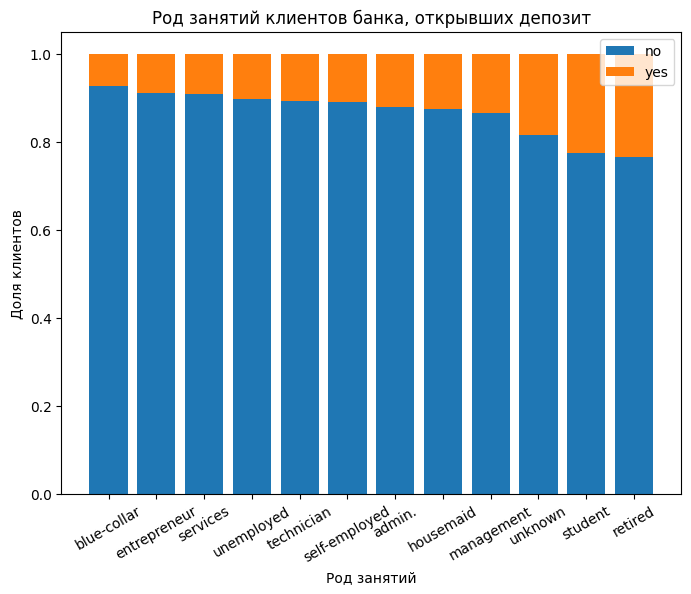

In [51]:
# Строим столбчатую многорядную сложенную диаграмму
plt.figure(figsize=(8, 6))
plt.bar(data['job'], data['no'])
plt.bar(data['job'], data['yes'], bottom=data['no'])
plt.title('Род занятий клиентов банка, открывших депозит')
plt.xlabel('Род занятий')
plt.ylabel('Доля клиентов')
plt.legend(['no', 'yes'])
plt.xticks(rotation = 30);

### Ящики с усами

In [53]:
# Готовим данные для графика
data1 = df['duration'][df['y'] == 1]
data2 = df['duration'][df['y'] == 0]
data1.head()

13    261
30    897
33    958
34    354
36     97
Name: duration, dtype: int64

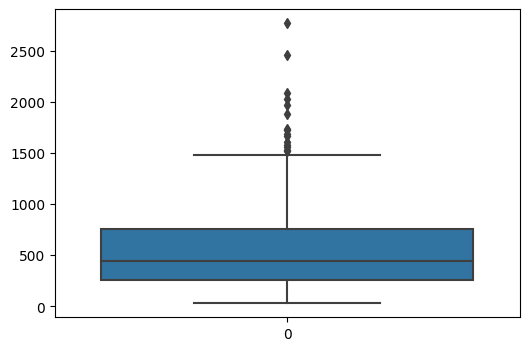

In [54]:
plt.figure(figsize=(6, 4))
sns.boxplot(data=[data1]);

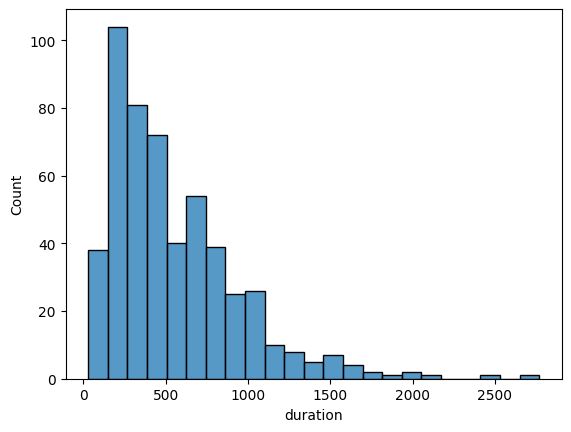

In [55]:
sns.histplot(x=data1);

#### Matplotlib

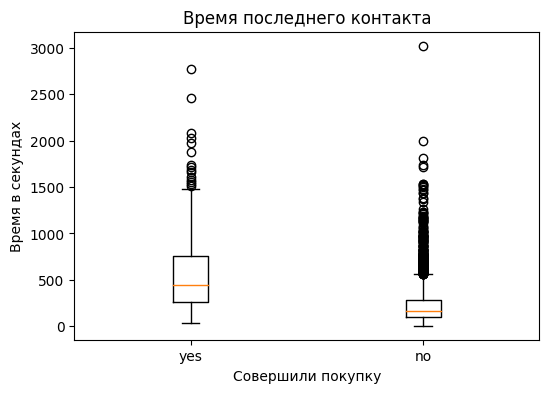

In [56]:
# Строим боксплот
plt.figure(figsize=(6, 4))
plt.boxplot([data1, data2])
plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')
plt.ylabel('Время в секундах')
plt.xticks([1, 2], ['yes', 'no']);

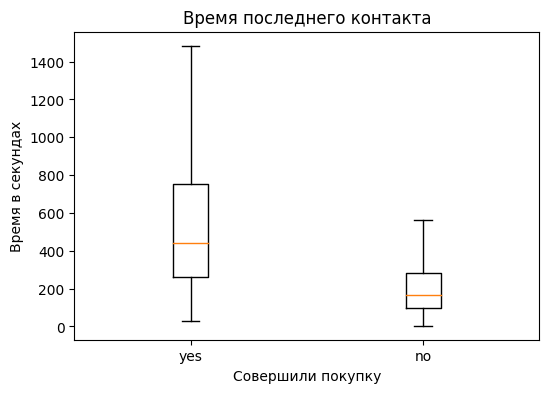

In [57]:
# Строим боксплот без выбросов 
plt.figure(figsize=(6, 4))
plt.boxplot([data1, data2], showfliers=False)
plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')
plt.ylabel('Время в секундах')
plt.xticks([1, 2], ['yes', 'no']);

#### Seaborn

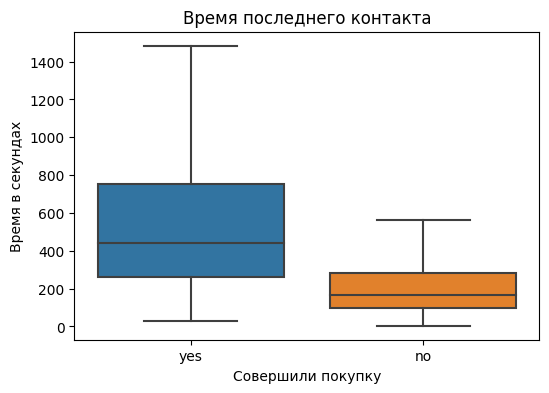

In [58]:
# Строим боксплот без выбросов 
plt.figure(figsize=(6, 4))
sns.boxplot(data=[data1, data2], showfliers=False)
plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')
plt.ylabel('Время в секундах')
plt.xticks([0, 1], ['yes', 'no']);

### Круговая диаграмма

In [60]:
# Готовим данные для графика
data = df['y'].value_counts()
data.index = ['no', 'yes']
data.head()

no     4000
yes     521
Name: y, dtype: int64

#### Matplotlib

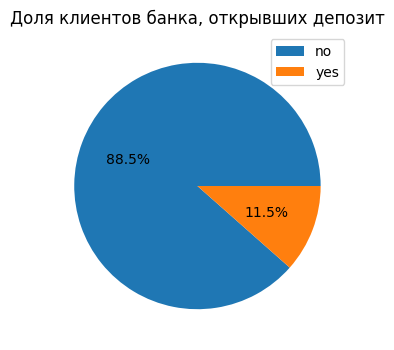

In [61]:
# Строим круговую диаграмму
plt.figure(figsize=(6, 4))
plt.pie(data, autopct='%1.1f%%')
plt.title('Доля клиентов банка, открывших депозит')
plt.legend(data.index);

## Визуальный анализ данных

- longitude - долгота
- latitude - широта
- housing_median_age - средний возраст дома
- total_rooms - общее количество комнат
- total_bedrooms - общее количество спален
- population - количество проживающих
- households - домохозяйства
- ocean_proximity - близость океана
- median_income - средний доход
- median_house_value - средняя стоимость дома

In [65]:
df = pd.read_csv("housing.csv")
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,id
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,0
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,1
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY,2
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY,3
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY,4


### Распределение вещественных признаков
- {'red', 'green', 'blue'} - дискретный признак ('red', 'green', 'blue', 'red', 'green', 'red')
- [0, 100] - вещественный признак (0, 5, 5.6, 10.5, 10.57)

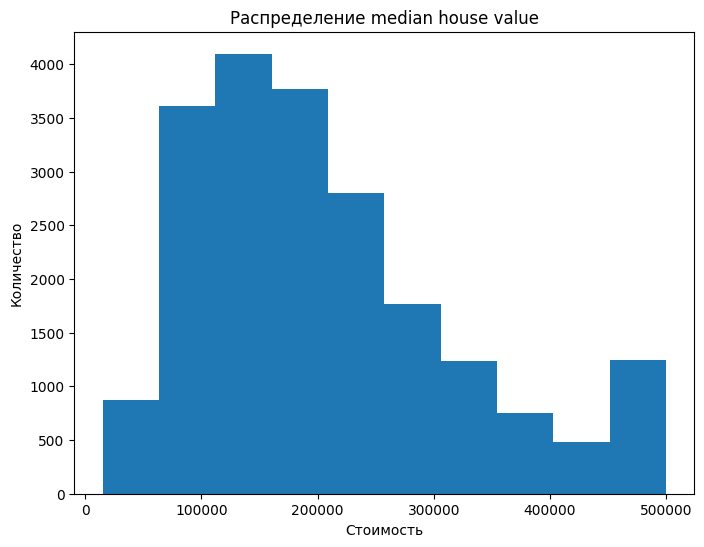

In [66]:
plt.figure(figsize=(8, 6))
plt.hist(df['median_house_value'])
plt.title('Распределение median house value')
plt.xlabel('Стоимость')
plt.ylabel('Количество');

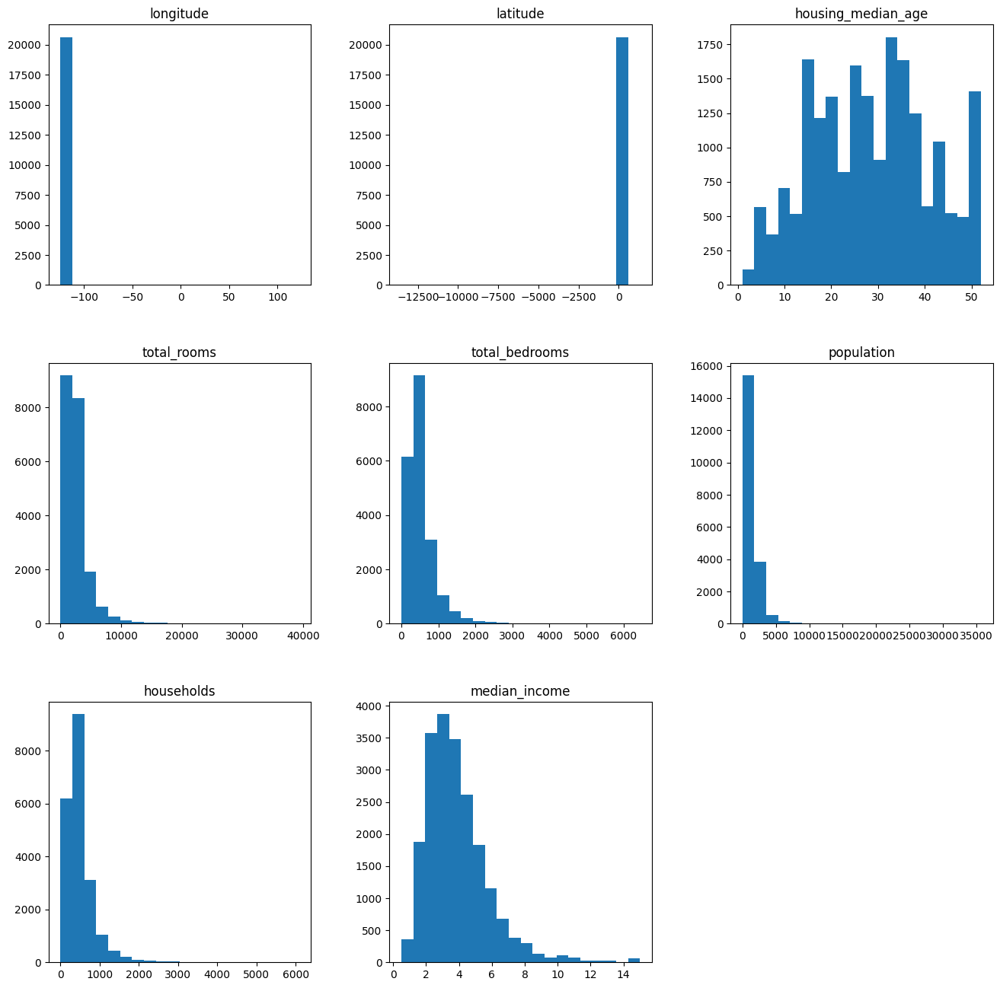

In [67]:
df_num_features = df.select_dtypes(include=['float64', 'float32', 'float16'])
df_num_features.drop('median_house_value', axis=1, inplace=True)
df_num_features.hist(figsize=(16, 16), bins=20, grid=False);

### Поиск выбросов с помощью box plot
#### Как строится box plot
- box - от 25% до 75% квантиля
- линия в середине box - медиана
- "усы"
__Как строятся "усы"__ - вариантов масса
- среднее +/- 3 сигма (стандартное отклонение)
- min / max
- median +/- 1.5*(q75 - q25),
- ...
- *Интерквартильный размах = q75 - q25

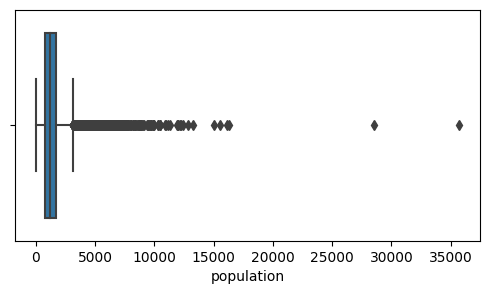

In [68]:
plt.figure(figsize=(6, 3))
sns.boxplot(x=df['population'], whis=1.5)
plt.xlabel('population')
plt.show()

### Анализ категориальных признаков

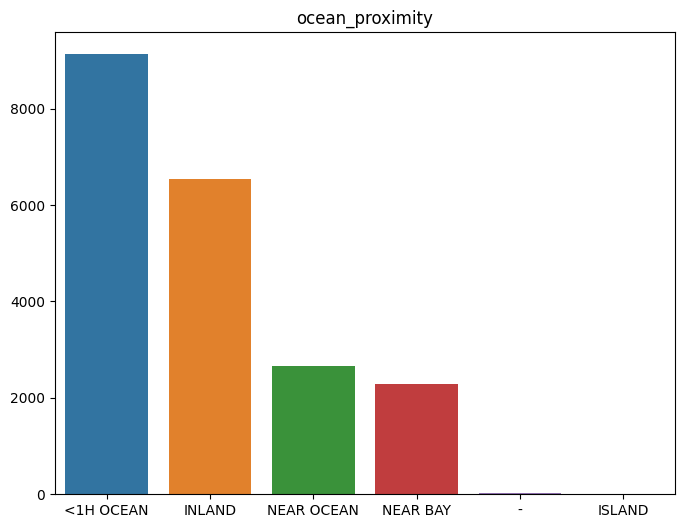

In [70]:
counts = df['ocean_proximity'].value_counts()
plt.figure(figsize=(8, 6))    
plt.title('ocean_proximity')
sns.barplot(x=counts.index, y=counts.values)
plt.show()

### Анализ взаимных распределени

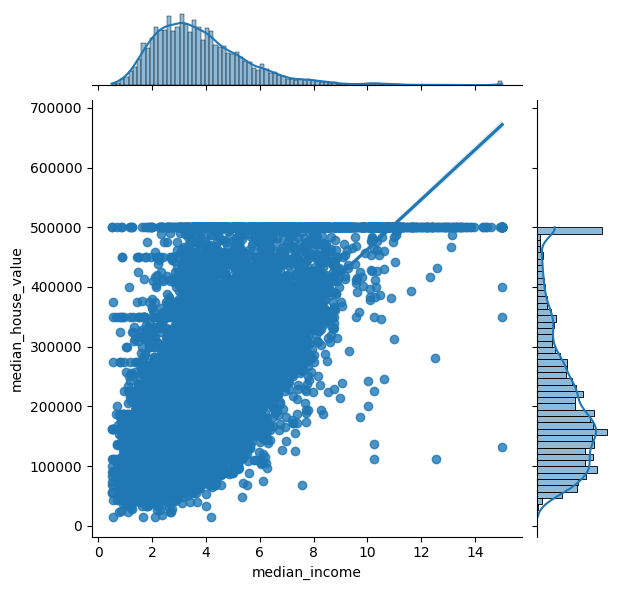

In [71]:
sns.jointplot(x=df['median_income'], y=df['median_house_value'], kind='reg');

ValueError: Contour levels must be increasing

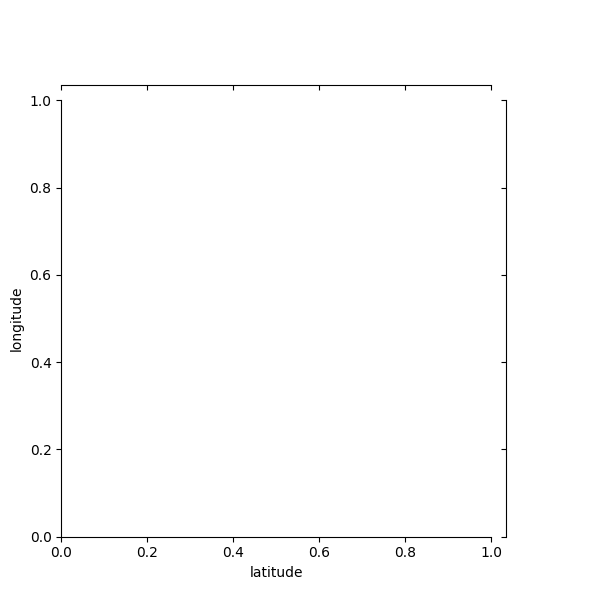

In [72]:
sns.jointplot(x=df['latitude'], y=df['longitude'], kind='kde');

Видно два города, имеет смысл посмотреть на зависимость по отдельности

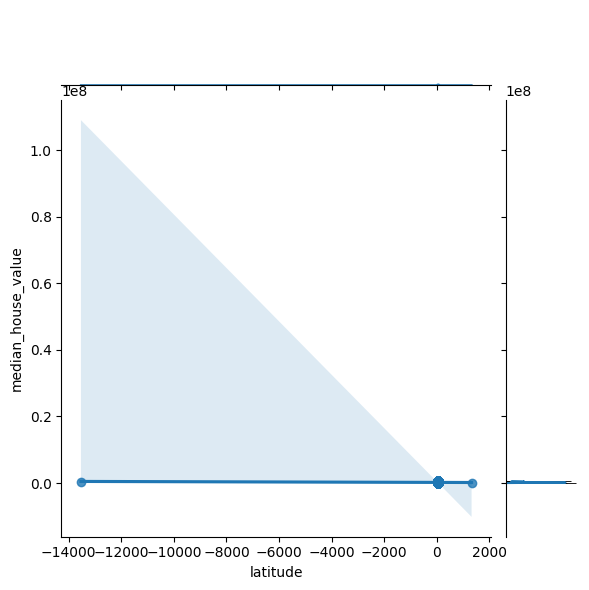

In [73]:
sns.jointplot(x=df['latitude'], y=df['median_house_value'], kind='reg');

In [ ]:
df_cut = df[df['latitude'] < 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

In [ ]:
df_cut = df[df['latitude'] >= 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

longitude

In [ ]:
sns.jointplot(x=df['longitude'], y=df['median_house_value'], kind='reg');

In [ ]:
df_cut = df[df['longitude'] < -120]
sns.jointplot(x=df_cut['longitude'], y=df_cut['median_house_value'], kind='reg');

In [ ]:
df_cut = df[df['longitude'] >= -120]
sns.jointplot(x=df_cut['longitude'], y=df_cut['median_house_value'], kind='reg');

### Категориальные / бинарные признаки

#### box plot

In [ ]:
plt.figure(figsize=(16, 8))
sns.boxplot(x=df['median_house_value'], y=df['ocean_proximity'], whis=1.5)
plt.xlabel('median_house_value')
plt.ylabel('ocean_proximity')
plt.title('Distribution of median_house_value by ocean_proximity');

#### Как строится box plot

Подробное объяснение

- box - от 25% до 75% квантиля
- линия в середине box - медиана
- "усы"
- Как строятся "усы" - вариантов масса
- среднее +/- 3 сигма (стандартное отклонение)
- min / max
- median +/- 1.5*(q75 - q25),
- ...
- *Интерквартильный размах = q75 - q25

### Матрица корреляций
- Показывает линейную связь между переменными
- Изменяется от -1 до 1
- Корреляция - мера только линейной связи

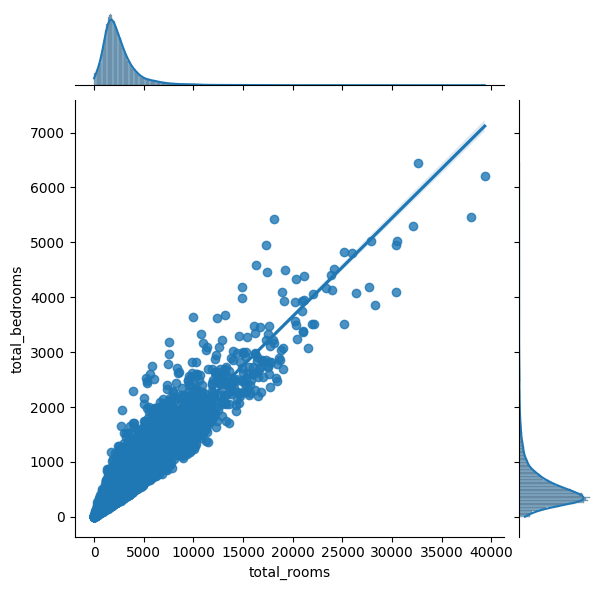

In [74]:
sns.jointplot(x=df['total_rooms'], y=df['total_bedrooms'], kind='reg');

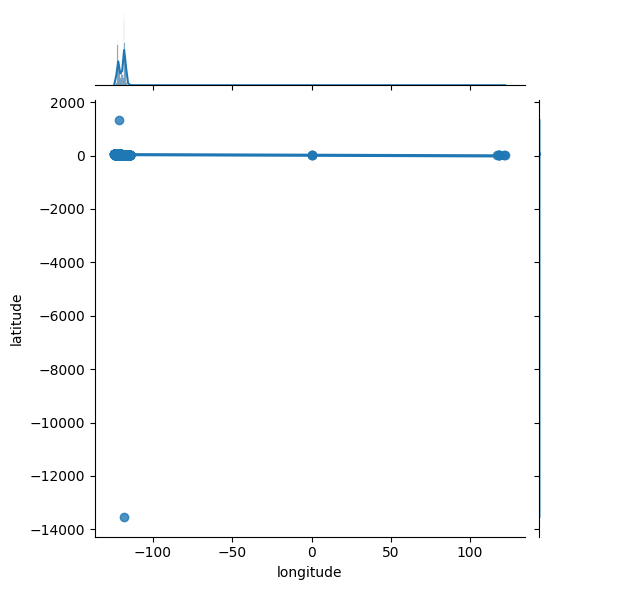

In [75]:
sns.jointplot(x=df['longitude'], y=df['latitude'], kind='reg');

In [ ]:
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
corr_matrix

In [ ]:
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)
sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm')
plt.title('Correlation matrix');

## Гео данные

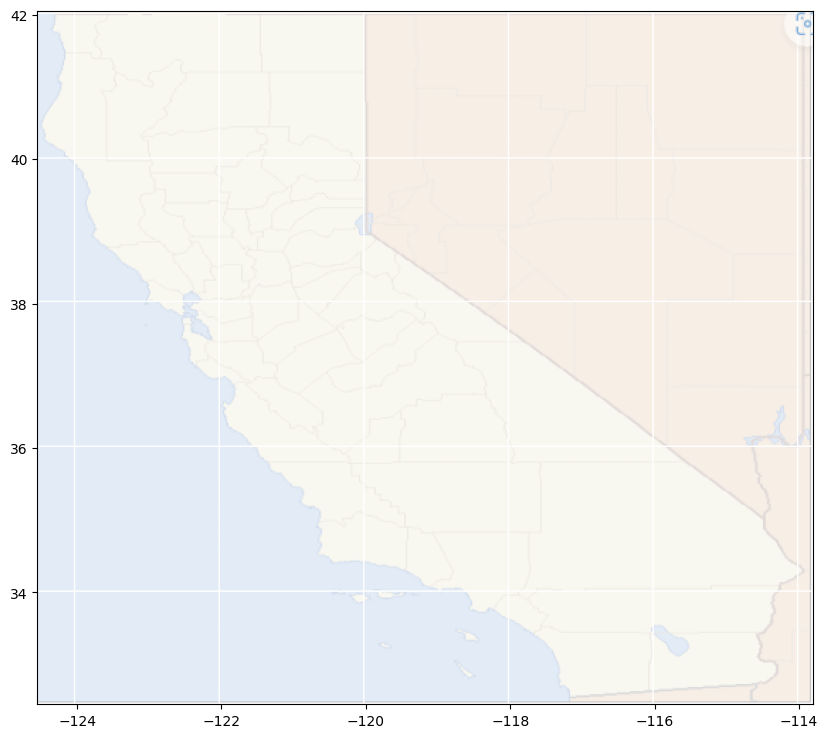

In [76]:
min_long = -124.55
max_long = -113.80
min_lat = 32.45
max_lat = 42.05
import matplotlib.image as img
california_map = img.imread('California_Map.png')
plt.figure(figsize=(12, 9))
plt.imshow(california_map,
           extent=[min_long, max_long, min_lat, max_lat], alpha=0.5);

Text(0, 0.5, 'Latitude')

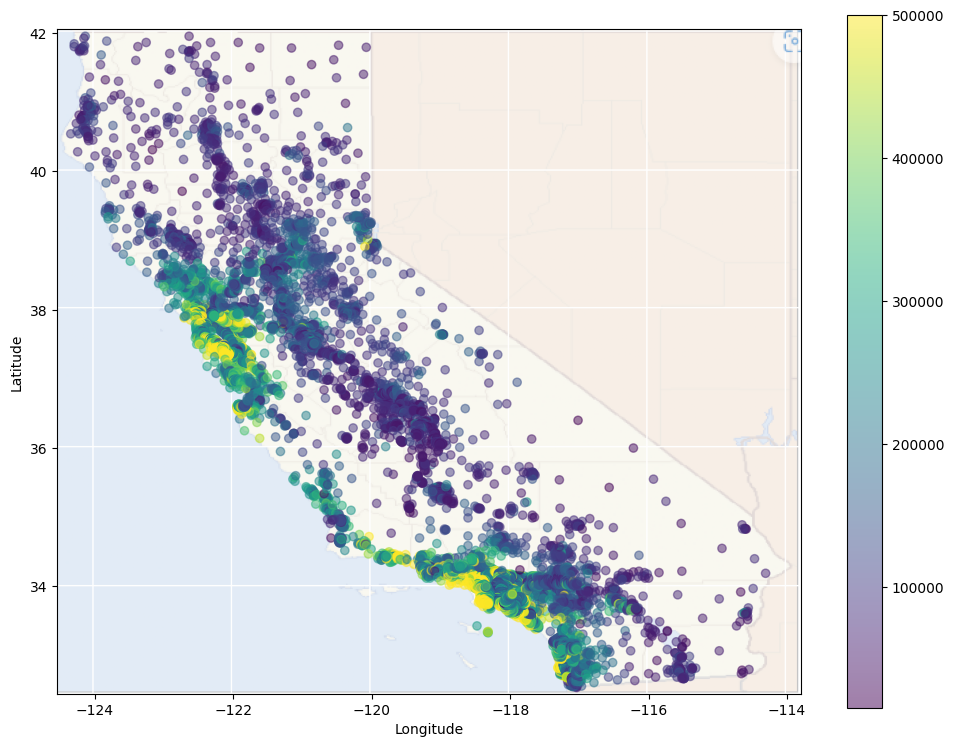

In [79]:
plt.figure(figsize=(12, 9))

sc = plt.scatter(df['longitude'], df['latitude'], alpha=0.5, c=df['median_house_value'])

plt.imshow(california_map,
           extent=[min_long, max_long, min_lat, max_lat], alpha=0.5)

plt.colorbar(sc)
plt.xlabel("Longitude")
plt.ylabel("Latitude")

## Folium
pip install folium

In [77]:
import folium
this_map = folium.Map(prefer_canvas=True)
def plotDot(point):
    folium.CircleMarker(
        location=[point.latitude, point.longitude],
        radius=2,
        popup=point.median_house_value
    ).add_to(this_map)
    
df.apply(plotDot, axis=1)
this_map.fit_bounds(this_map.get_bounds())
this_map

## Kepler**
- conda install -c conda-forge keplergl
- pip install keplergl==0.1.1

In [ ]:
from keplergl import KeplerGl 
map_ = KeplerGl(height=700)
map_.add_data(df, 'Data')
map_.save_to_html(file_name='./california.html')

In [78]:
User Guide: https://docs.kepler.gl/docs/keplergl-jupyter
Map saved to ./california.html!
## Summary
1. Матрица корреляции
2. Знакомство с признаками
- Плотность распределения (sns.distplot/sns.kdeplot/plt.hist - Узнать распределение признака)
- sns.violinplot - Узнать распределение признака
- Столбчатая диаграмма (sns.barplot/plt.bar - Узнать распределение категориального признака)
- Ящик с усами (sns.boxplot/plt.boxplot - Узнать диапазон значений)
- sns.jointplot - Взаимное изменение признаков
- plt.pie - Изобразить долю объектов от всего кол-ва
3. Поиск выбросов
- sns.distplot/sns.kdeplot/plt.hist - Искать хвосты слева и справа
- sns.boxplot - Всё, что выходит за пределы усов - выбросы

Seaborn - https://seaborn.pydata.org/examples/index.html

Matplotlib - https://matplotlib.org/3.1.0/gallery/index.html

SyntaxError: invalid syntax (1903482920.py, line 1)